<h1>DeepFake Starter Kit</h1>

# <a id='2'>Preliminary data exploration</a>

## Load packages

In [1]:
import numpy as np
import pandas as pd
import os
import matplotlib
import seaborn as sns
import matplotlib.pyplot as plt
from tqdm import tqdm_notebook
%matplotlib inline 
import cv2 as cv

## Load data

In [2]:
DATA_FOLDER = '../input/deepfake-detection-challenge'
TRAIN_SAMPLE_FOLDER = 'train_sample_videos'
TEST_FOLDER = 'test_videos'

print(f"Train samples: {len(os.listdir(os.path.join(DATA_FOLDER, TRAIN_SAMPLE_FOLDER)))}")
print(f"Test samples: {len(os.listdir(os.path.join(DATA_FOLDER, TEST_FOLDER)))}")

Train samples: 401
Test samples: 400


We also added a face detection resource.

In [3]:
FACE_DETECTION_FOLDER = '../input/haar-cascades-for-face-detection'
print(f"Face detection resources: {os.listdir(FACE_DETECTION_FOLDER)}")

Face detection resources: ['haarcascade_upperbody.xml', 'haarcascade_eye.xml', 'haarcascade_frontalface_default.xml', 'haarcascade_eye_tree_eyeglasses.xml', 'haarcascade_fullbody.xml', 'haarcascade_frontalface_alt_tree.xml', 'haarcascade_frontalface_alt.xml', 'haarcascade_smile.xml', 'haarcascade_profileface.xml', 'haarcascade_frontalface_alt2.xml']


## Check files type

Here we check the train data files extensions. Most of the files looks to have `mp4` extension, let's check if there is other extension as well.

In [4]:
train_list = list(os.listdir(os.path.join(DATA_FOLDER, TRAIN_SAMPLE_FOLDER)))
ext_dict = []
for file in train_list:
    file_ext = file.split('.')[1]
    if (file_ext not in ext_dict):
        ext_dict.append(file_ext)
print(f"Extensions: {ext_dict}")      

Extensions: ['mp4', 'json']


Let's count how many files with each extensions there are.

In [5]:
for file_ext in ext_dict:
    print(f"Files with extension `{file_ext}`: {len([file for file in train_list if  file.endswith(file_ext)])}")

Files with extension `mp4`: 400
Files with extension `json`: 1


Let's repeat the same process for test videos folder.

In [6]:
test_list = list(os.listdir(os.path.join(DATA_FOLDER, TEST_FOLDER)))
ext_dict = []
for file in test_list:
    file_ext = file.split('.')[1]
    if (file_ext not in ext_dict):
        ext_dict.append(file_ext)
print(f"Extensions: {ext_dict}")
for file_ext in ext_dict:
    print(f"Files with extension `{file_ext}`: {len([file for file in train_list if  file.endswith(file_ext)])}")

Extensions: ['mp4']
Files with extension `mp4`: 400


Let's check the `json` file first.

In [7]:
json_file = [file for file in train_list if  file.endswith('json')][0]
print(f"JSON file: {json_file}")

JSON file: metadata.json


Aparently here is a metadata file. Let's explore this JSON file.

In [8]:
def get_meta_from_json(path):
    df = pd.read_json(os.path.join(DATA_FOLDER, path, json_file))
    df = df.T
    return df

meta_train_df = get_meta_from_json(TRAIN_SAMPLE_FOLDER)
meta_train_df.head()

,label,split,original
aagfhgtpmv.mp4,FAKE,train,vudstovrck.mp4
aapnvogymq.mp4,FAKE,train,jdubbvfswz.mp4
abarnvbtwb.mp4,REAL,train,None
abofeumbvv.mp4,FAKE,train,atvmxvwyns.mp4
abqwwspghj.mp4,FAKE,train,qzimuostzz.mp4


# <a id="3">Meta data exploration</a>

Let's explore now the meta data in train sample. 

## Missing data

We start by checking for any missing values.  

In [9]:
def missing_data(data):
    total = data.isnull().sum()
    percent = (data.isnull().sum()/data.isnull().count()*100)
    tt = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
    types = []
    for col in data.columns:
        dtype = str(data[col].dtype)
        types.append(dtype)
    tt['Types'] = types
    return(np.transpose(tt))

In [10]:
missing_data(meta_train_df)

,label,split,original
Total,0,0,77
Percent,0,0,19.25
Types,object,object,object


There are missing data 19.25% of the samples (or 77). We suspect that actually the real data has missing original (if we generalize from the data we glimpsed). Let's check this hypothesis.

In [11]:
missing_data(meta_train_df.loc[meta_train_df.label=='REAL'])

,label,split,original
Total,0,0,77
Percent,0,0,100
Types,object,object,object


Indeed, all missing `original` data are the one associated with `REAL` label.  

## Unique values

Let's check into more details the unique values.

In [12]:
def unique_values(data):
    total = data.count()
    tt = pd.DataFrame(total)
    tt.columns = ['Total']
    uniques = []
    for col in data.columns:
        unique = data[col].nunique()
        uniques.append(unique)
    tt['Uniques'] = uniques
    return(np.transpose(tt))

In [13]:
unique_values(meta_train_df)

,label,split,original
Total,400,400,323
Uniques,2,1,209


* We observe that `original` label has the same pattern for uniques values. We know that we have 77 missing data (that's why total is only 323) and we observe that we do have 209 unique examples.  

## Most frequent originals

Let's look now to the most frequent originals uniques in train sample data.  

In [14]:
def most_frequent_values(data):
    total = data.count()
    tt = pd.DataFrame(total)
    tt.columns = ['Total']
    items = []
    vals = []
    for col in data.columns:
        itm = data[col].value_counts().index[0]
        val = data[col].value_counts().values[0]
        items.append(itm)
        vals.append(val)
    tt['Most frequent item'] = items
    tt['Frequence'] = vals
    tt['Percent from total'] = np.round(vals / total * 100, 3)
    return(np.transpose(tt))

In [15]:
most_frequent_values(meta_train_df)

,label,split,original
Total,400,400,323
Most frequent item,FAKE,train,atvmxvwyns.mp4
Frequence,323,400,6
Percent from total,80.75,100,1.858


We see that most frequent **label** is `FAKE` (80.75%), `meawmsgiti.mp4` is the most frequent **original** (6 samples).

Let's do now some data distribution visualizations.

In [16]:
def plot_count(feature, title, df, size=1):
    '''
    Plot count of classes / feature
    param: feature - the feature to analyze
    param: title - title to add to the graph
    param: df - dataframe from which we plot feature's classes distribution 
    param: size - default 1.
    '''
    f, ax = plt.subplots(1,1, figsize=(4*size,4))
    total = float(len(df))
    g = sns.countplot(df[feature], order = df[feature].value_counts().index[:20], palette='Set3')
    g.set_title("Number and percentage of {}".format(title))
    if(size > 2):
        plt.xticks(rotation=90, size=8)
    for p in ax.patches:
        height = p.get_height()
        ax.text(p.get_x()+p.get_width()/2.,
                height + 3,
                '{:1.2f}%'.format(100*height/total),
                ha="center") 
    plt.show()    

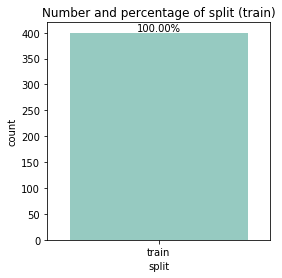

In [17]:
plot_count('split', 'split (train)', meta_train_df)

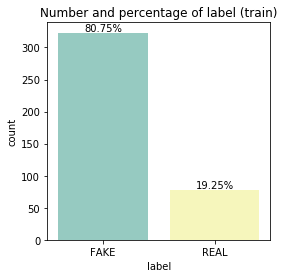

In [18]:
plot_count('label', 'label (train)', meta_train_df)

As we can see, the `REAL` are only 19.25% in train sample videos, with the `FAKE`s acounting for 80.75% of the samples. 


# <a id="4">Video data exploration</a>


In the following we will explore some of the video data. 


## Missing video (or meta) data

We check first if the list of files in the meta info and the list from the folder are the same.



In [19]:
meta = np.array(list(meta_train_df.index))
storage = np.array([file for file in train_list if  file.endswith('mp4')])
print(f"Metadata: {meta.shape[0]}, Folder: {storage.shape[0]}")
print(f"Files in metadata and not in folder: {np.setdiff1d(meta,storage,assume_unique=False).shape[0]}")
print(f"Files in folder and not in metadata: {np.setdiff1d(storage,meta,assume_unique=False).shape[0]}")

Metadata: 400, Folder: 400
Files in metadata and not in folder: 0
Files in folder and not in metadata: 0


Let's visualize now the data.  

We select first a list of fake videos.

## Few fake videos

In [20]:
fake_train_sample_video = list(meta_train_df.loc[meta_train_df.label=='FAKE'].sample(3).index)
fake_train_sample_video

['bdbhekrrwo.mp4', 'akvmwkdyuv.mp4', 'esyhwdfnxs.mp4']

From [4] ([Basic EDA Face Detection, split video, ROI](https://www.kaggle.com/marcovasquez/basic-eda-face-detection-split-video-roi)) we modified a function for displaying a selected image from a video.

In [21]:
def display_image_from_video(video_path):
    '''
    input: video_path - path for video
    process:
    1. perform a video capture from the video
    2. read the image
    3. display the image
    '''
    capture_image = cv.VideoCapture(video_path) 
    ret, frame = capture_image.read()
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(111)
    frame = cv.cvtColor(frame, cv.COLOR_BGR2RGB)
    ax.imshow(frame)

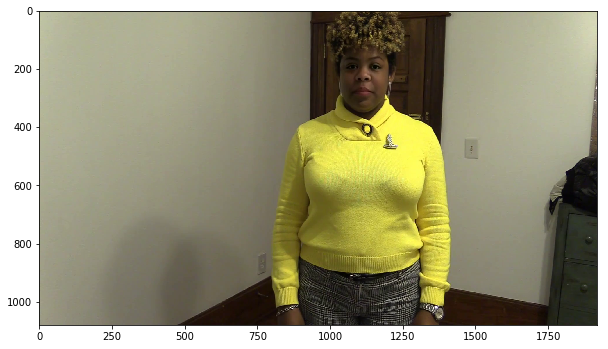

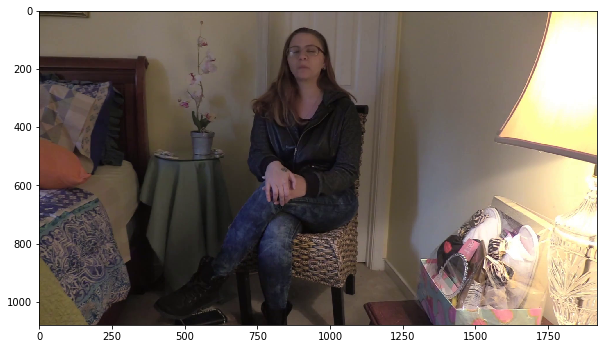

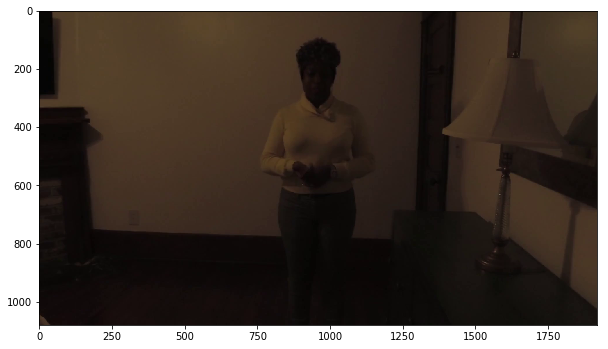

In [22]:
for video_file in fake_train_sample_video:
    display_image_from_video(os.path.join(DATA_FOLDER, TRAIN_SAMPLE_FOLDER, video_file))

Let's try now the same for few of the images that are real.  


## Few real videos

In [23]:
real_train_sample_video = list(meta_train_df.loc[meta_train_df.label=='REAL'].sample(3).index)
real_train_sample_video

['edyncaijwx.mp4', 'bwipwzzxxu.mp4', 'bilnggbxgu.mp4']

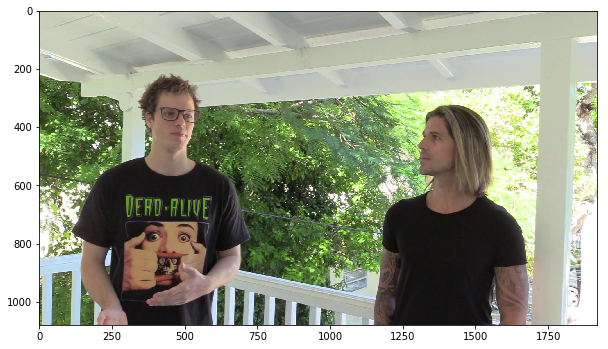

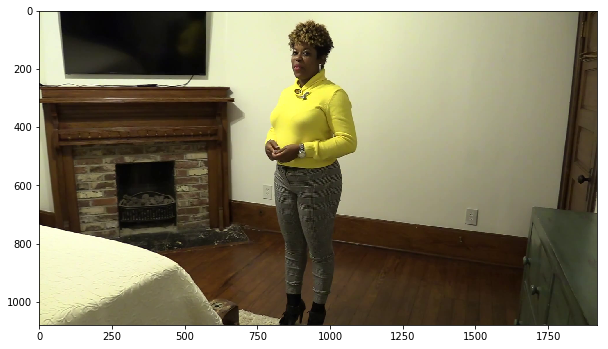

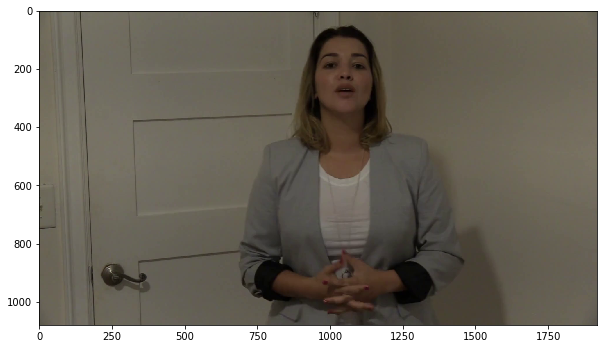

In [24]:
for video_file in real_train_sample_video:
    display_image_from_video(os.path.join(DATA_FOLDER, TRAIN_SAMPLE_FOLDER, video_file))

## Videos with same original

Let's look now to set of samples with the same original.

In [25]:
meta_train_df['original'].value_counts()[0:5]

atvmxvwyns.mp4    6
meawmsgiti.mp4    6
kgbkktcjxf.mp4    5
qeumxirsme.mp4    5
xngpzquyhs.mp4    4
Name: original, dtype: int64

We pick one of the originals with largest number of samples.   

We also modify our visualization function to work with multiple images.

In [26]:
def display_image_from_video_list(video_path_list, video_folder=TRAIN_SAMPLE_FOLDER):
    '''
    input: video_path_list - path for video
    process:
    0. for each video in the video path list
        1. perform a video capture from the video
        2. read the image
        3. display the image
    '''
    plt.figure()
    fig, ax = plt.subplots(2,3,figsize=(16,8))
    # we only show images extracted from the first 6 videos
    for i, video_file in enumerate(video_path_list[0:6]):
        video_path = os.path.join(DATA_FOLDER, video_folder,video_file)
        capture_image = cv.VideoCapture(video_path) 
        ret, frame = capture_image.read()
        frame = cv.cvtColor(frame, cv.COLOR_BGR2RGB)
        ax[i//3, i%3].imshow(frame)
        ax[i//3, i%3].set_title(f"Video: {video_file}")
        ax[i//3, i%3].axis('on')

<Figure size 432x288 with 0 Axes>

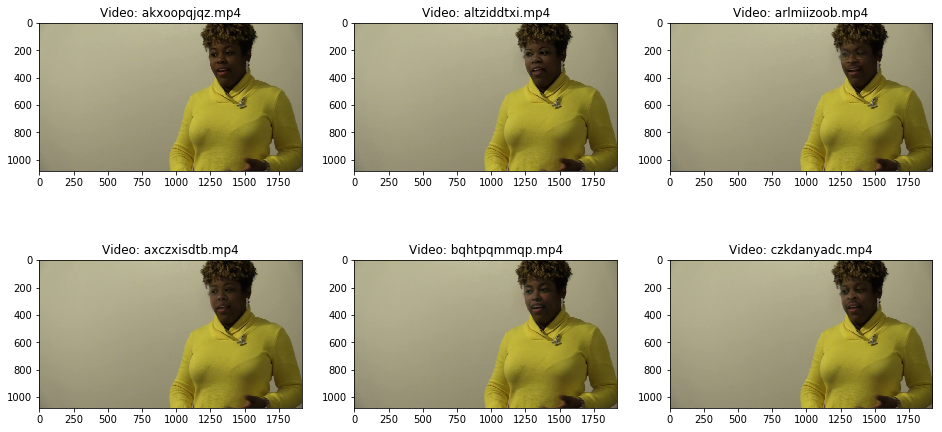

In [27]:
same_original_fake_train_sample_video = list(meta_train_df.loc[meta_train_df.original=='meawmsgiti.mp4'].index)
display_image_from_video_list(same_original_fake_train_sample_video)

Let's look now to a different selection of videos with the same original. 

<Figure size 432x288 with 0 Axes>

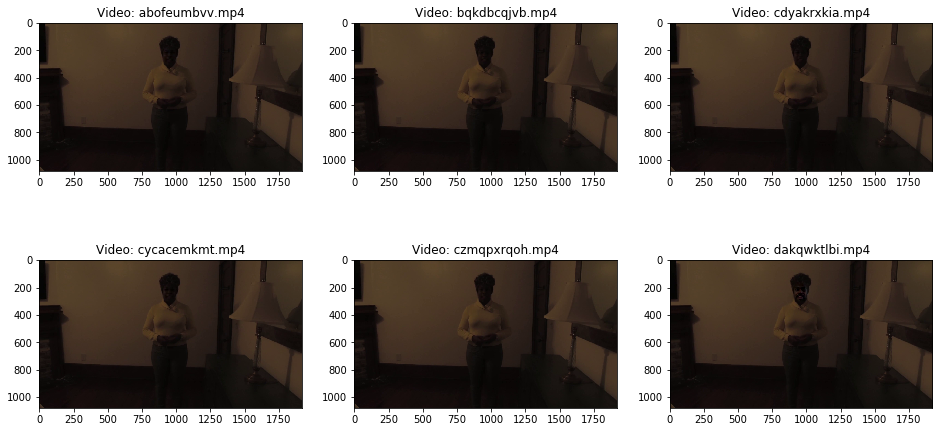

In [28]:
same_original_fake_train_sample_video = list(meta_train_df.loc[meta_train_df.original=='atvmxvwyns.mp4'].index)
display_image_from_video_list(same_original_fake_train_sample_video)

<Figure size 432x288 with 0 Axes>

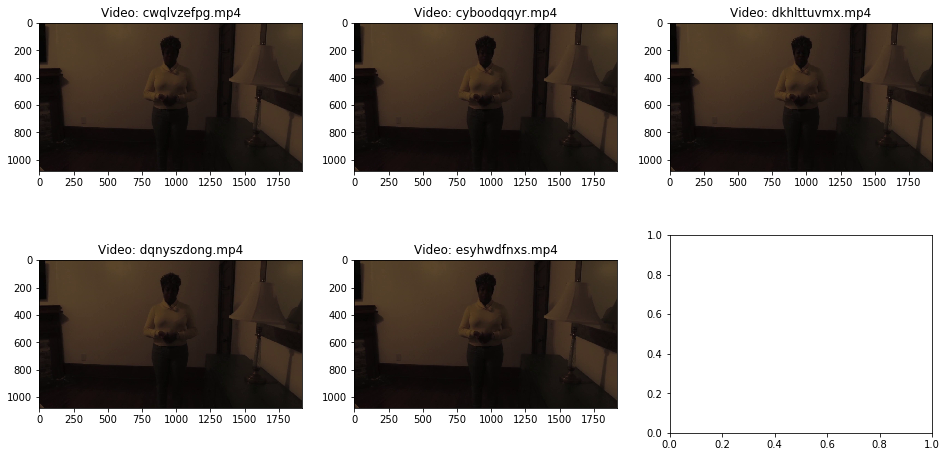

In [29]:
same_original_fake_train_sample_video = list(meta_train_df.loc[meta_train_df.original=='qeumxirsme.mp4'].index)
display_image_from_video_list(same_original_fake_train_sample_video)

<Figure size 432x288 with 0 Axes>

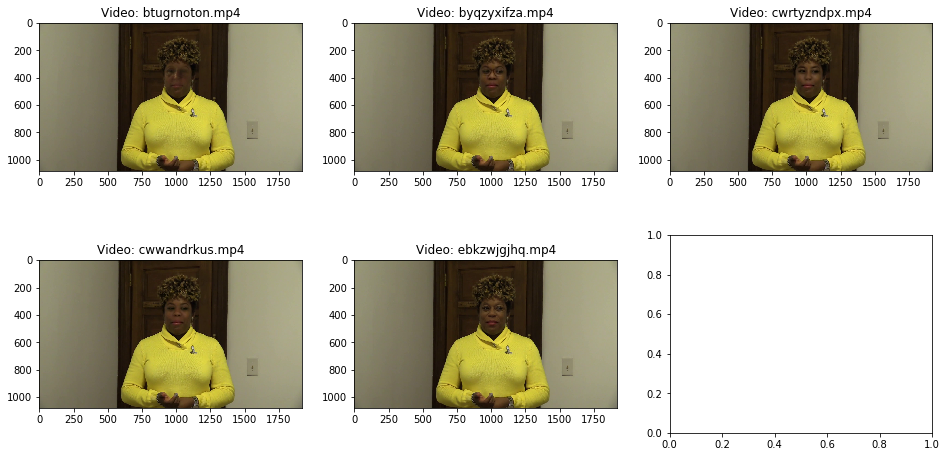

In [30]:
same_original_fake_train_sample_video = list(meta_train_df.loc[meta_train_df.original=='kgbkktcjxf.mp4'].index)
display_image_from_video_list(same_original_fake_train_sample_video)

## Test video files

Let's also look to few of the test data files.

In [31]:
test_videos = pd.DataFrame(list(os.listdir(os.path.join(DATA_FOLDER, TEST_FOLDER))), columns=['video'])

In [32]:
test_videos.head()

,video
0,qooxnxqqjb.mp4
1,hierggamuo.mp4
2,ocgdbrgmtq.mp4
3,icbsahlivv.mp4
4,prhmixykhr.mp4


Let's visualize now one of the videos.

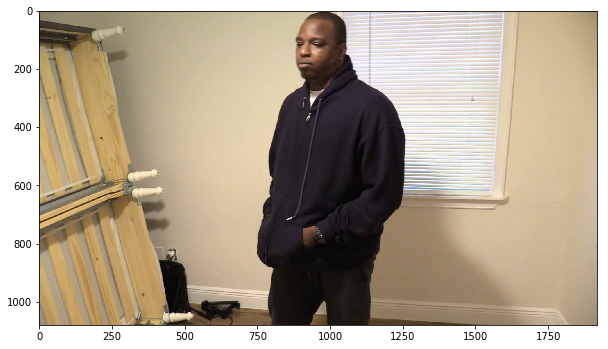

In [33]:
display_image_from_video(os.path.join(DATA_FOLDER, TEST_FOLDER, test_videos.iloc[0].video))

Let's look to some more videos from test set.

<Figure size 432x288 with 0 Axes>

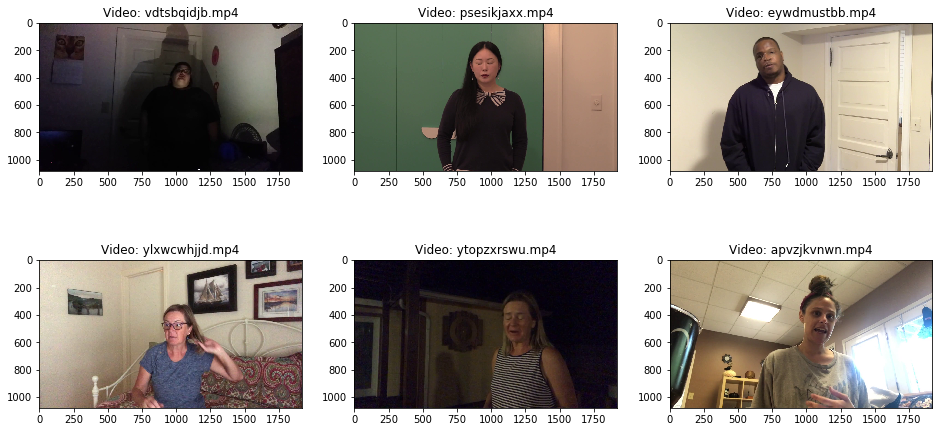

In [34]:
display_image_from_video_list(test_videos.sample(6).video, TEST_FOLDER)

# <a id='5'>Face detection</a>  

From [5] ([Face Detection using OpenCV](https://www.kaggle.com/serkanpeldek/face-detection-with-opencv)) by [@serkanpeldek](https://www.kaggle.com/serkanpeldek) we got and slightly modified the functions to extract face, profile face, eyes and smile.  

The class ObjectDetector initialize the cascade classifier (using the imported resource). The function **detect** uses a method of the CascadeClassifier to detect objects into images - in this case the face, eye, smile or profile face.

In [35]:
class ObjectDetector():
    '''
    Class for Object Detection
    '''
    def __init__(self,object_cascade_path):
        '''
        param: object_cascade_path - path for the *.xml defining the parameters for {face, eye, smile, profile}
        detection algorithm
        source of the haarcascade resource is: https://github.com/opencv/opencv/tree/master/data/haarcascades
        '''

        self.objectCascade=cv.CascadeClassifier(object_cascade_path)


    def detect(self, image, scale_factor=1.3,
               min_neighbors=5,
               min_size=(20,20)):
        '''
        Function return rectangle coordinates of object for given image
        param: image - image to process
        param: scale_factor - scale factor used for object detection
        param: min_neighbors - minimum number of parameters considered during object detection
        param: min_size - minimum size of bounding box for object detected
        '''
        rects=self.objectCascade.detectMultiScale(image,
                                                scaleFactor=scale_factor,
                                                minNeighbors=min_neighbors,
                                                minSize=min_size)
        return rects

We load the resources for frontal face, eye, smile and profile face detection.  

Then we initialize the `ObjectDetector` objects defined above with the respective resources, to use CascadeClassfier for each specific task.

In [36]:
#Frontal face, profile, eye and smile  haar cascade loaded
frontal_cascade_path= os.path.join(FACE_DETECTION_FOLDER,'haarcascade_frontalface_default.xml')
eye_cascade_path= os.path.join(FACE_DETECTION_FOLDER,'haarcascade_eye.xml')
profile_cascade_path= os.path.join(FACE_DETECTION_FOLDER,'haarcascade_profileface.xml')
smile_cascade_path= os.path.join(FACE_DETECTION_FOLDER,'haarcascade_smile.xml')

#Detector object created
# frontal face
fd=ObjectDetector(frontal_cascade_path)
# eye
ed=ObjectDetector(eye_cascade_path)
# profile face
pd=ObjectDetector(profile_cascade_path)
# smile
sd=ObjectDetector(smile_cascade_path)

We also define a function for detection and display of all these specific objects.  

The function call the **detect** method of the **ObjectDetector** object. For each object we are using a different shape and color, as following:
* Frontal face: green rectangle;  
* Eye: red circle;  
* Smile: red rectangle;  
* Profile face: blue rectangle.  

Note: due to a huge amount of false positive, we deactivate for now the smile detector.

In [37]:
def detect_objects(image, scale_factor, min_neighbors, min_size):
    '''
    Objects detection function
    Identify frontal face, eyes, smile and profile face and display the detected objects over the image
    param: image - the image extracted from the video
    param: scale_factor - scale factor parameter for `detect` function of ObjectDetector object
    param: min_neighbors - min neighbors parameter for `detect` function of ObjectDetector object
    param: min_size - minimum size parameter for f`detect` function of ObjectDetector object
    '''
    
    image_gray=cv.cvtColor(image, cv.COLOR_BGR2GRAY)


    eyes=ed.detect(image_gray,
                   scale_factor=scale_factor,
                   min_neighbors=min_neighbors,
                   min_size=(int(min_size[0]/2), int(min_size[1]/2)))

    for x, y, w, h in eyes:
        #detected eyes shown in color image
        cv.circle(image,(int(x+w/2),int(y+h/2)),(int((w + h)/4)),(0, 0,255),3)
 
    # deactivated due to many false positive
    #smiles=sd.detect(image_gray,
    #               scale_factor=scale_factor,
    #               min_neighbors=min_neighbors,
    #               min_size=(int(min_size[0]/2), int(min_size[1]/2)))

    #for x, y, w, h in smiles:
    #    #detected smiles shown in color image
    #    cv.rectangle(image,(x,y),(x+w, y+h),(0, 0,255),3)


    profiles=pd.detect(image_gray,
                   scale_factor=scale_factor,
                   min_neighbors=min_neighbors,
                   min_size=min_size)

    for x, y, w, h in profiles:
        #detected profiles shown in color image
        cv.rectangle(image,(x,y),(x+w, y+h),(255, 0,0),3)

    faces=fd.detect(image_gray,
                   scale_factor=scale_factor,
                   min_neighbors=min_neighbors,
                   min_size=min_size)

    for x, y, w, h in faces:
        #detected faces shown in color image
        cv.rectangle(image,(x,y),(x+w, y+h),(0, 255,0),3)

    # image
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(111)
    image = cv.cvtColor(image, cv.COLOR_BGR2RGB)
    ax.imshow(image)

The following function extracts an image from a video and then call the function that extracts the face rectangle from the image and display the rectangle above the image.

In [38]:
def extract_image_objects(video_file, video_set_folder=TRAIN_SAMPLE_FOLDER):
    '''
    Extract one image from the video and then perform face/eyes/smile/profile detection on the image
    param: video_file - the video from which to extract the image from which we extract the face
    '''
    video_path = os.path.join(DATA_FOLDER, video_set_folder,video_file)
    capture_image = cv.VideoCapture(video_path) 
    ret, frame = capture_image.read()
    #frame = cv.cvtColor(frame, cv.COLOR_BGR2RGB)
    detect_objects(image=frame, 
            scale_factor=1.3, 
            min_neighbors=5, 
            min_size=(50, 50))  
  

We apply the function for face detection for a selection of images from train sample videos.

byqzyxifza.mp4
cwrtyzndpx.mp4
cwwandrkus.mp4


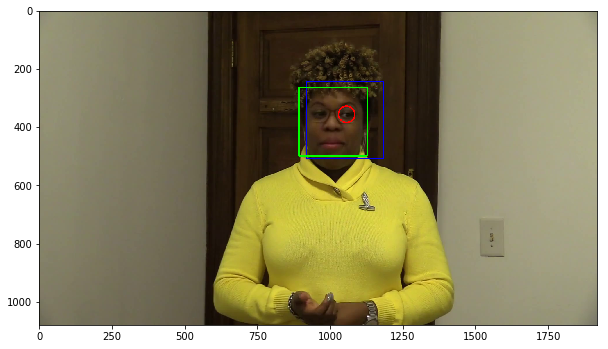

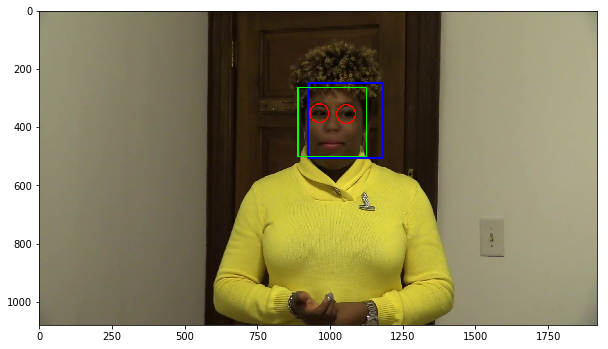

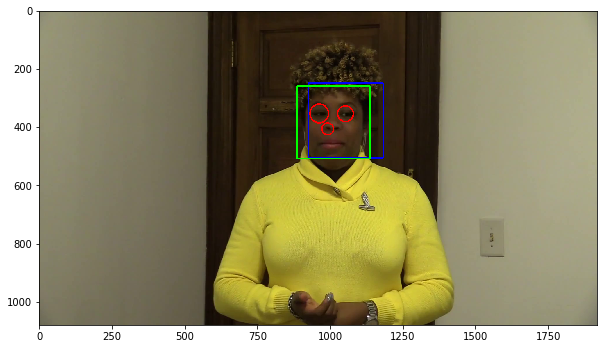

In [39]:
same_original_fake_train_sample_video = list(meta_train_df.loc[meta_train_df.original=='kgbkktcjxf.mp4'].index)
for video_file in same_original_fake_train_sample_video[1:4]:
    print(video_file)
    extract_image_objects(video_file)

cvaksbpssm.mp4
degpbqvcay.mp4
bqqpbzjgup.mp4


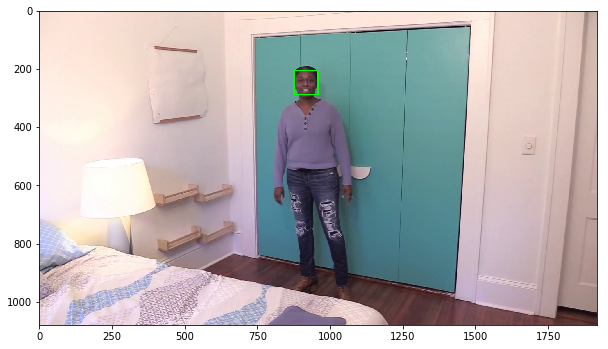

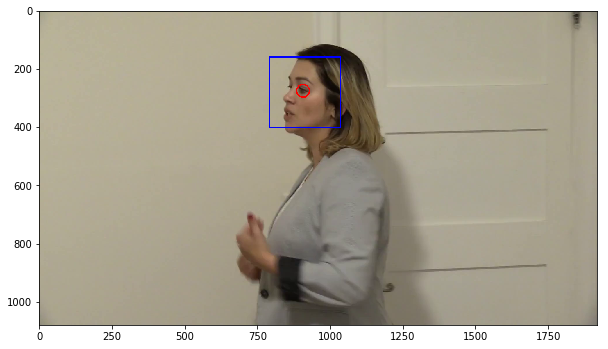

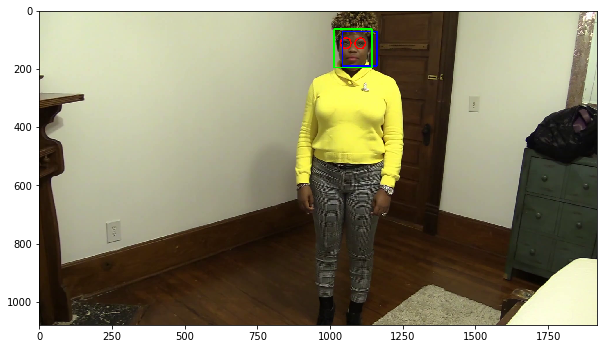

In [40]:
train_subsample_video = list(meta_train_df.sample(3).index)
for video_file in train_subsample_video:
    print(video_file)
    extract_image_objects(video_file)

Let's look to a small collection of samples from test videos.

dpevefkefv.mp4
czfqlbcfpa.mp4
uxuvkrjhws.mp4


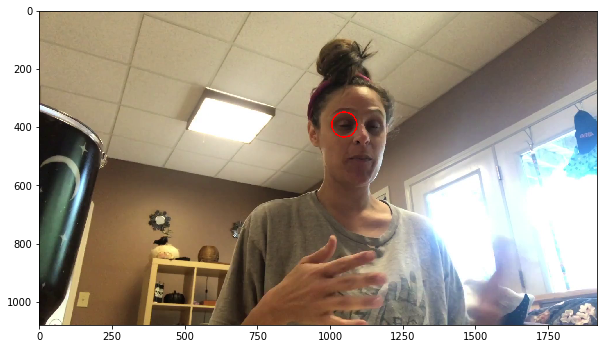

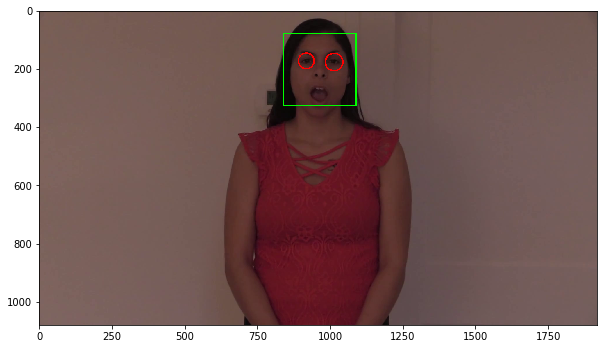

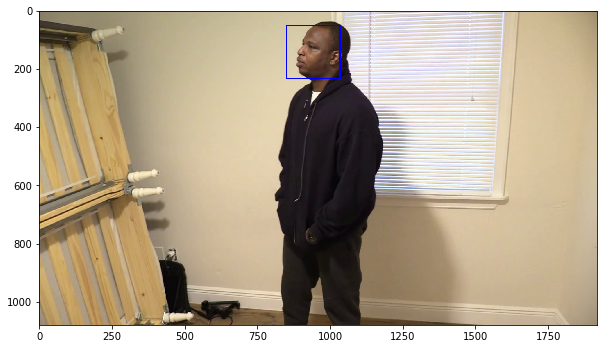

In [41]:
subsample_test_videos = list(test_videos.sample(3).video)
for video_file in subsample_test_videos:
    print(video_file)
    extract_image_objects(video_file, TEST_FOLDER)

We can observe that in some cases, when the subject is not looking frontaly or when the luminosity is low, the algorithm for face detection is not detecting the face or eyes correctly. Due to a large amount of false positive, we deactivated for now the smile detector.

## Play video files  

In [42]:
fake_videos = list(meta_train_df.loc[meta_train_df.label=='FAKE'].index)

In [43]:
from IPython.display import HTML
from base64 import b64encode

def play_video(video_file, subset=TRAIN_SAMPLE_FOLDER):
    '''
    Display video
    param: video_file - the name of the video file to display
    param: subset - the folder where the video file is located (can be TRAIN_SAMPLE_FOLDER or TEST_Folder)
    '''
    video_url = open(os.path.join(DATA_FOLDER, subset,video_file),'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(video_url).decode()
    return HTML("""<video width=500 controls><source src="%s" type="video/mp4"></video>""" % data_url)

In [45]:
play_video(fake_videos[1])

In [47]:
play_video(fake_videos[3])

In [52]:
play_video(fake_videos[15])

From visual inspection of these fakes videos, in some cases is very easy to spot the anomalies created when engineering the deep fake, in some cases is more difficult.

## Checking Accuracy of the Detection

In [54]:
from sklearn.metrics import confusion_matrix, accuracy_score

# Replace these with your actual labels and predicted results
# 1 indicates 'Deepfake' and 0 indicates 'Real'
actual_labels = [1, 0, 1, 0, 1, 0, 1, 1, 0, 0]  # Ground truth labels
predicted_labels = [1, 0, 1, 0, 0, 0, 1, 1, 1, 0]  # Model predictions

# Compute the confusion matrix
cm = confusion_matrix(actual_labels, predicted_labels)
print("Confusion Matrix:\n", cm)

# Compute the accuracy score
accuracy = accuracy_score(actual_labels, predicted_labels)
print("Accuracy: {:.2f}%".format(accuracy * 100))

Confusion Matrix:
 [[4 1]
 [1 4]]
Accuracy: 80.00%
